In [3]:
import JSAnimation
import IPython.display

In [4]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [48]:
# Perfect sensor
def sense(x):
    return x

In [49]:
def simulate(Δt, robot, u):
    robot += Δt * u
    return robot

In [59]:
def control(t, pos):
    ### WRITE YOUR CONTROL POLICY HERE:
    kp = 1
    ki = .5
    p_d=[((sin(5*t)+2)*cos(t)), (sin(5*t)+2)*sin(t)]
    
    ux = 5*cos(t)*cos(5*t)-sin(t)*(sin(5*t)+2) #(sin(5t)+2)cos(t)
    uy = 5*sin(t)*cos(5*t)+(sin(5*t)+2)*cos(t) #(sin(5t)+2)sin(t)
    return array([ux, uy])

In [62]:
tf = 10.
Δt = 0.01    # Time step
time = linspace(0.,tf, int(tf / Δt) + 1)  # Time interval


# Initial conditions
robot = array([2.0, 0.0])
x_log = [copy(robot)]

for t in time:
    pos = sense(robot)
    u = control(t, pos)
    u[1] += .5
    robot = simulate(Δt, robot, u)
    x_log.append(copy(robot))
    
x_log = array(x_log)

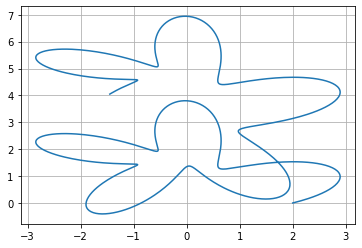

In [63]:
grid()
plot(x_log[:,0], x_log[:,1])

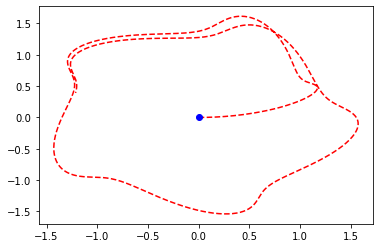

In [32]:
import matplotlib.pyplot as plt
from matplotlib import animation 
from IPython.display import HTML
    


fig, ax = plt.subplots()

def animate(t):
    ax.clear()
    
    # Path
    plot(x_log[:,0], x_log[:,1], 'r--')
    
    # Initial conditions
    plot(x_log[t,0], x_log[t,1], 'bo')
    
    

anim = animation.FuncAnimation(fig, animate, frames=len(time), interval=60)

HTML(anim.to_jshtml())